In [1]:
from __future__ import print_function

import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from torchvision import models
from IPython.display import HTML
import time

# Set random seed for reproducibility
manualSeed = 999
# manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)

# Seed() method used to initialise a random number generator
# The random number generator requires a number to start with (seed value) to be able to generate a random number
# If you the same seed value you'll get the same set of random numbers
random.seed(manualSeed)

# Sets the seed for randomly generating values with pytorch
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
### Dataroots for the different datasets
home_dir = "/home/a/Projects/dcgans-2d-pytorch/" # on machine
ext_dir = "/media/a/Seagate Basic/home/a/Projects/dggan-pytorch-2d-images/" # on external hard drive

## Celeba Dataset: 
# dataset_name = "celeba"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/celeba/"

## Scan The World main dataset:
# dataset_name = "scan-the-world-main-images"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/scan-the-world-main-images/"

## 2D Scan The World busts dataset: 
# dataset_name = "scan-the-world-busts-images"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/scan-the-world-busts-images/"

## Mixed god dataset:
# dataset_name = "mixed-gods"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/mixed-gods/"

# Sanitised mixed god dataset
# dataset_name = "sanitised-mixed-gods"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/sanitised-mixed-gods/"

# Sanitised mixed god dataset
# dataset_name = "sanitised-mixed-gods-scan-the-world"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/sanitised-mixed-gods-scan-the-world/"

# Unsanitised full dataset
# dataset_name = "unsanitised-full-dataset"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/all-scan-the-world-images/"

# # Facial recognition full dataset
# dataset_name = "facerecog-recog-full-dataset"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/facerecog-all-scan-the-world/"

# Tags classifier - busts
# dataset_name = "tags-classifier-fullbody"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/busts-tags-classifier/"
    
# Tags classifier - fullbody
# dataset_name = "tags-classifier-fullbody-seed-1312"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/fullbody-tags-classifier/"

# Fully manually sanitised fullbody dataset
dataset_name = "fully-manually-sanitised-fullbody-dataset-noise-vector-256"
dataroot = ext_dir + "data/fully-manually-sanitised-fullbody-dataset/"

# Fully manually sanitised busts dataset
# dataset_name = "fully-manually-sanitised-busts-dataset"
# dataroot = ext_dir + "data/fully-manually-sanitised-busts-dataset/"

workers = 2 
batch_size = 128
image_size = 64 
nc = 3
nz = 256
ngf = 64
ndf = 64
num_epochs = 100
lr = 0.0002
beta1 = 0.5
ngpu = 1

In [3]:
# Make output directory
results_dir = "results_" + dataset_name + "_epochs_" + str(num_epochs) + "_" + time.strftime("%Y%m%d-%H%M%S")
path = os.path.join(home_dir + "outputs", results_dir)
os.mkdir(path)

Size of the dataset:  32490


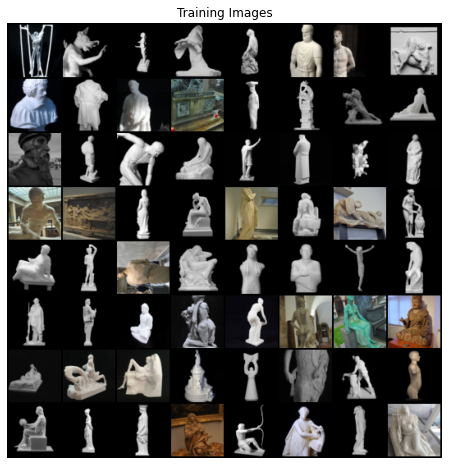

In [4]:
# Create dataset by standardising and normalizing the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Create the dataloader - python iterable over the dataset
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

dataset_size = len(dataloader.dataset)
print("Size of the dataset: ", dataset_size)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images before any training has begun
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [5]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [6]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            
            # state size. (ngf*8) x 4 x 4          
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            
            # state size. (ngf*2) x 16 x 16
            
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            
            
            
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [7]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(256, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [8]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
        
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            
            
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [9]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [10]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [11]:
import csv
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
D_fake_losses = []
D_real_losses = []
D_x_acc = []
D_G_z1_acc = []
D_G_z2_acc = []
iters = 0

wtr = csv.writer(open (os.path.join(path,'training_stats.csv'), 'w', newline=''))
wtr.writerow(["Current Epoch", "Total number of epochs", "Iteration", "Batch_size", "D_losses", "D_fake_losses", "D_real_losses", "G_losses", "D_accuracy", "D_G_z1_accurancy", "D_G_z2_accuracy"])
print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output - note this is loss on fake 
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_D_fake: %.4f\tLoss_D_real: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errD_fake.item(), errD_real.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            wtr.writerow([epoch, num_epochs, i, len(dataloader), errD.item(), errD_fake.item(), errD_real.item(), errG.item(), D_x, D_G_z1, D_G_z2])

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        D_fake_losses.append(errD_fake.item())
        D_real_losses.append(errD_real.item())
        D_x_acc.append(D_x)
        D_G_z1_acc.append(D_G_z1)
        D_G_z2_acc.append(D_G_z2)
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/100][0/254]	Loss_D: 1.5736	Loss_D_fake: 0.6818	Loss_D_real: 0.8918	Loss_G: 3.3957	D(x): 0.4553	D(G(z)): 0.4319 / 0.0487
[0/100][50/254]	Loss_D: 0.0907	Loss_D_fake: 0.0000	Loss_D_real: 0.0907	Loss_G: 10.8003	D(x): 0.9584	D(G(z)): 0.0000 / 0.0000
[0/100][100/254]	Loss_D: 0.6728	Loss_D_fake: 0.0751	Loss_D_real: 0.5978	Loss_G: 2.0530	D(x): 0.6863	D(G(z)): 0.0699 / 0.1571
[0/100][150/254]	Loss_D: 0.2534	Loss_D_fake: 0.1369	Loss_D_real: 0.1165	Loss_G: 2.8961	D(x): 0.9150	D(G(z)): 0.1194 / 0.0818
[0/100][200/254]	Loss_D: 0.2809	Loss_D_fake: 0.1853	Loss_D_real: 0.0956	Loss_G: 4.5225	D(x): 0.9241	D(G(z)): 0.1547 / 0.0175
[0/100][250/254]	Loss_D: 0.2387	Loss_D_fake: 0.1542	Loss_D_real: 0.0845	Loss_G: 1.6228	D(x): 0.9351	D(G(z)): 0.1260 / 0.2413
[1/100][0/254]	Loss_D: 0.2543	Loss_D_fake: 0.2287	Loss_D_real: 0.0256	Loss_G: 4.7494	D(x): 0.9757	D(G(z)): 0.1892 / 0.0198
[1/100][50/254]	Loss_D: 0.4206	Loss_D_fake: 0.1432	Loss_D_real: 0.2774	Loss_G: 3.4252	D(x): 0.8097	D(G(

[11/100][0/254]	Loss_D: 0.8081	Loss_D_fake: 0.5364	Loss_D_real: 0.2717	Loss_G: 2.5420	D(x): 0.7834	D(G(z)): 0.3764 / 0.1022
[11/100][50/254]	Loss_D: 1.3255	Loss_D_fake: 1.2731	Loss_D_real: 0.0524	Loss_G: 4.5131	D(x): 0.9502	D(G(z)): 0.6798 / 0.0183
[11/100][100/254]	Loss_D: 0.9883	Loss_D_fake: 0.2800	Loss_D_real: 0.7083	Loss_G: 1.8099	D(x): 0.5363	D(G(z)): 0.2278 / 0.1958
[11/100][150/254]	Loss_D: 1.1649	Loss_D_fake: 0.1163	Loss_D_real: 1.0486	Loss_G: 1.1069	D(x): 0.4231	D(G(z)): 0.0962 / 0.4201
[11/100][200/254]	Loss_D: 0.9976	Loss_D_fake: 0.6091	Loss_D_real: 0.3886	Loss_G: 2.5747	D(x): 0.7015	D(G(z)): 0.4189 / 0.1097
[11/100][250/254]	Loss_D: 0.7120	Loss_D_fake: 0.2804	Loss_D_real: 0.4315	Loss_G: 2.1013	D(x): 0.6724	D(G(z)): 0.2289 / 0.1568
[12/100][0/254]	Loss_D: 0.7471	Loss_D_fake: 0.4723	Loss_D_real: 0.2748	Loss_G: 2.2328	D(x): 0.7790	D(G(z)): 0.3540 / 0.1452
[12/100][50/254]	Loss_D: 0.8913	Loss_D_fake: 0.1834	Loss_D_real: 0.7079	Loss_G: 0.9801	D(x): 0.5293	D(G(z)): 0.1595 / 0.417

[22/100][0/254]	Loss_D: 0.8980	Loss_D_fake: 0.8506	Loss_D_real: 0.0474	Loss_G: 3.7015	D(x): 0.9548	D(G(z)): 0.5239 / 0.0338
[22/100][50/254]	Loss_D: 1.2392	Loss_D_fake: 1.0966	Loss_D_real: 0.1426	Loss_G: 4.6138	D(x): 0.8772	D(G(z)): 0.5940 / 0.0207
[22/100][100/254]	Loss_D: 0.9980	Loss_D_fake: 0.0756	Loss_D_real: 0.9224	Loss_G: 0.5268	D(x): 0.4461	D(G(z)): 0.0702 / 0.6284
[22/100][150/254]	Loss_D: 0.8872	Loss_D_fake: 0.8389	Loss_D_real: 0.0483	Loss_G: 3.4902	D(x): 0.9540	D(G(z)): 0.5123 / 0.0454
[22/100][200/254]	Loss_D: 0.7100	Loss_D_fake: 0.1552	Loss_D_real: 0.5547	Loss_G: 1.7629	D(x): 0.6201	D(G(z)): 0.1309 / 0.2139
[22/100][250/254]	Loss_D: 0.6631	Loss_D_fake: 0.2859	Loss_D_real: 0.3772	Loss_G: 1.7506	D(x): 0.7154	D(G(z)): 0.2308 / 0.2057
[23/100][0/254]	Loss_D: 0.6113	Loss_D_fake: 0.2820	Loss_D_real: 0.3293	Loss_G: 2.0117	D(x): 0.7413	D(G(z)): 0.2316 / 0.1700
[23/100][50/254]	Loss_D: 0.6313	Loss_D_fake: 0.5497	Loss_D_real: 0.0816	Loss_G: 2.9638	D(x): 0.9267	D(G(z)): 0.3809 / 0.074

[33/100][0/254]	Loss_D: 0.4527	Loss_D_fake: 0.3889	Loss_D_real: 0.0637	Loss_G: 3.4390	D(x): 0.9413	D(G(z)): 0.2872 / 0.0494
[33/100][50/254]	Loss_D: 0.6390	Loss_D_fake: 0.0758	Loss_D_real: 0.5632	Loss_G: 1.3527	D(x): 0.6119	D(G(z)): 0.0696 / 0.3202
[33/100][100/254]	Loss_D: 0.6606	Loss_D_fake: 0.0383	Loss_D_real: 0.6223	Loss_G: 1.4087	D(x): 0.5957	D(G(z)): 0.0364 / 0.3491
[33/100][150/254]	Loss_D: 0.4128	Loss_D_fake: 0.3258	Loss_D_real: 0.0870	Loss_G: 3.6395	D(x): 0.9207	D(G(z)): 0.2479 / 0.0371
[33/100][200/254]	Loss_D: 0.5850	Loss_D_fake: 0.1320	Loss_D_real: 0.4529	Loss_G: 2.3810	D(x): 0.6739	D(G(z)): 0.1158 / 0.1414
[33/100][250/254]	Loss_D: 0.4203	Loss_D_fake: 0.1487	Loss_D_real: 0.2716	Loss_G: 2.4163	D(x): 0.7794	D(G(z)): 0.1218 / 0.1305
[34/100][0/254]	Loss_D: 0.3689	Loss_D_fake: 0.2813	Loss_D_real: 0.0875	Loss_G: 3.7717	D(x): 0.9191	D(G(z)): 0.2237 / 0.0330
[34/100][50/254]	Loss_D: 0.2961	Loss_D_fake: 0.1125	Loss_D_real: 0.1835	Loss_G: 3.2149	D(x): 0.8445	D(G(z)): 0.0993 / 0.056

[44/100][0/254]	Loss_D: 0.7014	Loss_D_fake: 0.6930	Loss_D_real: 0.0084	Loss_G: 6.3911	D(x): 0.9918	D(G(z)): 0.4483 / 0.0028
[44/100][50/254]	Loss_D: 0.6985	Loss_D_fake: 0.2182	Loss_D_real: 0.4803	Loss_G: 1.6830	D(x): 0.6591	D(G(z)): 0.1759 / 0.2419
[44/100][100/254]	Loss_D: 0.2866	Loss_D_fake: 0.0945	Loss_D_real: 0.1921	Loss_G: 2.9560	D(x): 0.8347	D(G(z)): 0.0853 / 0.0805
[44/100][150/254]	Loss_D: 0.2679	Loss_D_fake: 0.1126	Loss_D_real: 0.1553	Loss_G: 2.9379	D(x): 0.8650	D(G(z)): 0.0991 / 0.0771
[44/100][200/254]	Loss_D: 0.2078	Loss_D_fake: 0.0673	Loss_D_real: 0.1405	Loss_G: 3.1828	D(x): 0.8756	D(G(z)): 0.0614 / 0.0714
[44/100][250/254]	Loss_D: 0.4014	Loss_D_fake: 0.3821	Loss_D_real: 0.0192	Loss_G: 4.6749	D(x): 0.9814	D(G(z)): 0.2825 / 0.0157
[45/100][0/254]	Loss_D: 0.2670	Loss_D_fake: 0.1363	Loss_D_real: 0.1307	Loss_G: 3.1470	D(x): 0.8839	D(G(z)): 0.1180 / 0.0637
[45/100][50/254]	Loss_D: 0.7616	Loss_D_fake: 0.7326	Loss_D_real: 0.0290	Loss_G: 5.8099	D(x): 0.9723	D(G(z)): 0.4539 / 0.005

[55/100][0/254]	Loss_D: 0.6088	Loss_D_fake: 0.4783	Loss_D_real: 0.1305	Loss_G: 4.7404	D(x): 0.8868	D(G(z)): 0.2932 / 0.0224
[55/100][50/254]	Loss_D: 0.2613	Loss_D_fake: 0.1239	Loss_D_real: 0.1375	Loss_G: 2.6821	D(x): 0.8808	D(G(z)): 0.1083 / 0.1035
[55/100][100/254]	Loss_D: 0.1678	Loss_D_fake: 0.1193	Loss_D_real: 0.0485	Loss_G: 4.2180	D(x): 0.9548	D(G(z)): 0.1014 / 0.0217
[55/100][150/254]	Loss_D: 0.6064	Loss_D_fake: 0.0225	Loss_D_real: 0.5839	Loss_G: 1.4216	D(x): 0.5947	D(G(z)): 0.0218 / 0.3329
[55/100][200/254]	Loss_D: 0.3273	Loss_D_fake: 0.2802	Loss_D_real: 0.0471	Loss_G: 4.3446	D(x): 0.9558	D(G(z)): 0.2094 / 0.0226
[55/100][250/254]	Loss_D: 1.6131	Loss_D_fake: 0.0053	Loss_D_real: 1.6078	Loss_G: 0.1347	D(x): 0.2788	D(G(z)): 0.0053 / 0.9075
[56/100][0/254]	Loss_D: 2.7158	Loss_D_fake: 0.0318	Loss_D_real: 2.6840	Loss_G: 0.1677	D(x): 0.1417	D(G(z)): 0.0296 / 0.8666
[56/100][50/254]	Loss_D: 0.3340	Loss_D_fake: 0.1783	Loss_D_real: 0.1558	Loss_G: 2.5030	D(x): 0.8657	D(G(z)): 0.1422 / 0.139

[66/100][0/254]	Loss_D: 0.1021	Loss_D_fake: 0.0883	Loss_D_real: 0.0139	Loss_G: 4.3380	D(x): 0.9865	D(G(z)): 0.0789 / 0.0219
[66/100][50/254]	Loss_D: 0.4755	Loss_D_fake: 0.0157	Loss_D_real: 0.4598	Loss_G: 1.2337	D(x): 0.6735	D(G(z)): 0.0154 / 0.4149
[66/100][100/254]	Loss_D: 0.0802	Loss_D_fake: 0.0580	Loss_D_real: 0.0221	Loss_G: 4.4549	D(x): 0.9784	D(G(z)): 0.0539 / 0.0214
[66/100][150/254]	Loss_D: 0.7143	Loss_D_fake: 0.0186	Loss_D_real: 0.6958	Loss_G: 2.2879	D(x): 0.5905	D(G(z)): 0.0139 / 0.1816
[66/100][200/254]	Loss_D: 0.3104	Loss_D_fake: 0.0428	Loss_D_real: 0.2676	Loss_G: 2.4299	D(x): 0.7955	D(G(z)): 0.0394 / 0.1620
[66/100][250/254]	Loss_D: 0.3300	Loss_D_fake: 0.2240	Loss_D_real: 0.1060	Loss_G: 3.7137	D(x): 0.9061	D(G(z)): 0.1773 / 0.0427
[67/100][0/254]	Loss_D: 0.1806	Loss_D_fake: 0.1192	Loss_D_real: 0.0614	Loss_G: 3.9864	D(x): 0.9428	D(G(z)): 0.0967 / 0.0365
[67/100][50/254]	Loss_D: 0.1939	Loss_D_fake: 0.0630	Loss_D_real: 0.1310	Loss_G: 4.2235	D(x): 0.8897	D(G(z)): 0.0564 / 0.029

[77/100][0/254]	Loss_D: 0.1507	Loss_D_fake: 0.0629	Loss_D_real: 0.0878	Loss_G: 4.2426	D(x): 0.9210	D(G(z)): 0.0582 / 0.0258
[77/100][50/254]	Loss_D: 0.1223	Loss_D_fake: 0.0882	Loss_D_real: 0.0341	Loss_G: 4.7273	D(x): 0.9671	D(G(z)): 0.0783 / 0.0168
[77/100][100/254]	Loss_D: 0.0719	Loss_D_fake: 0.0302	Loss_D_real: 0.0417	Loss_G: 4.3028	D(x): 0.9601	D(G(z)): 0.0286 / 0.0264
[77/100][150/254]	Loss_D: 2.3382	Loss_D_fake: 2.3159	Loss_D_real: 0.0223	Loss_G: 5.5871	D(x): 0.9831	D(G(z)): 0.7952 / 0.0141
[77/100][200/254]	Loss_D: 0.4801	Loss_D_fake: 0.2721	Loss_D_real: 0.2080	Loss_G: 3.2140	D(x): 0.8352	D(G(z)): 0.1894 / 0.0730
[77/100][250/254]	Loss_D: 0.2679	Loss_D_fake: 0.1539	Loss_D_real: 0.1140	Loss_G: 4.3916	D(x): 0.9011	D(G(z)): 0.1198 / 0.0227
[78/100][0/254]	Loss_D: 0.2664	Loss_D_fake: 0.1511	Loss_D_real: 0.1153	Loss_G: 3.7053	D(x): 0.8993	D(G(z)): 0.1128 / 0.0452
[78/100][50/254]	Loss_D: 0.1820	Loss_D_fake: 0.0796	Loss_D_real: 0.1024	Loss_G: 3.9228	D(x): 0.9081	D(G(z)): 0.0635 / 0.042

[88/100][0/254]	Loss_D: 0.0772	Loss_D_fake: 0.0150	Loss_D_real: 0.0622	Loss_G: 4.9539	D(x): 0.9418	D(G(z)): 0.0145 / 0.0153
[88/100][50/254]	Loss_D: 0.0493	Loss_D_fake: 0.0288	Loss_D_real: 0.0204	Loss_G: 4.9558	D(x): 0.9800	D(G(z)): 0.0257 / 0.0129
[88/100][100/254]	Loss_D: 0.5863	Loss_D_fake: 0.4151	Loss_D_real: 0.1712	Loss_G: 3.5847	D(x): 0.8578	D(G(z)): 0.2826 / 0.0460
[88/100][150/254]	Loss_D: 0.2535	Loss_D_fake: 0.1981	Loss_D_real: 0.0554	Loss_G: 5.0538	D(x): 0.9486	D(G(z)): 0.1461 / 0.0171
[88/100][200/254]	Loss_D: 0.1290	Loss_D_fake: 0.1240	Loss_D_real: 0.0050	Loss_G: 5.1443	D(x): 0.9950	D(G(z)): 0.1078 / 0.0115
[88/100][250/254]	Loss_D: 0.2027	Loss_D_fake: 0.1945	Loss_D_real: 0.0082	Loss_G: 6.3694	D(x): 0.9919	D(G(z)): 0.1546 / 0.0039
[89/100][0/254]	Loss_D: 0.0474	Loss_D_fake: 0.0162	Loss_D_real: 0.0313	Loss_G: 6.0682	D(x): 0.9698	D(G(z)): 0.0150 / 0.0067
[89/100][50/254]	Loss_D: 0.0846	Loss_D_fake: 0.0765	Loss_D_real: 0.0081	Loss_G: 5.4570	D(x): 0.9919	D(G(z)): 0.0617 / 0.009

[99/100][0/254]	Loss_D: 1.5277	Loss_D_fake: 1.5101	Loss_D_real: 0.0176	Loss_G: 7.3613	D(x): 0.9835	D(G(z)): 0.6796 / 0.0019
[99/100][50/254]	Loss_D: 0.1598	Loss_D_fake: 0.0800	Loss_D_real: 0.0798	Loss_G: 5.1798	D(x): 0.9280	D(G(z)): 0.0703 / 0.0129
[99/100][100/254]	Loss_D: 0.1209	Loss_D_fake: 0.0567	Loss_D_real: 0.0642	Loss_G: 4.9365	D(x): 0.9423	D(G(z)): 0.0485 / 0.0182
[99/100][150/254]	Loss_D: 0.0811	Loss_D_fake: 0.0246	Loss_D_real: 0.0564	Loss_G: 3.7345	D(x): 0.9470	D(G(z)): 0.0236 / 0.0502
[99/100][200/254]	Loss_D: 0.0342	Loss_D_fake: 0.0265	Loss_D_real: 0.0077	Loss_G: 5.7930	D(x): 0.9924	D(G(z)): 0.0248 / 0.0082
[99/100][250/254]	Loss_D: 0.0978	Loss_D_fake: 0.0230	Loss_D_real: 0.0748	Loss_G: 4.7972	D(x): 0.9336	D(G(z)): 0.0217 / 0.0201


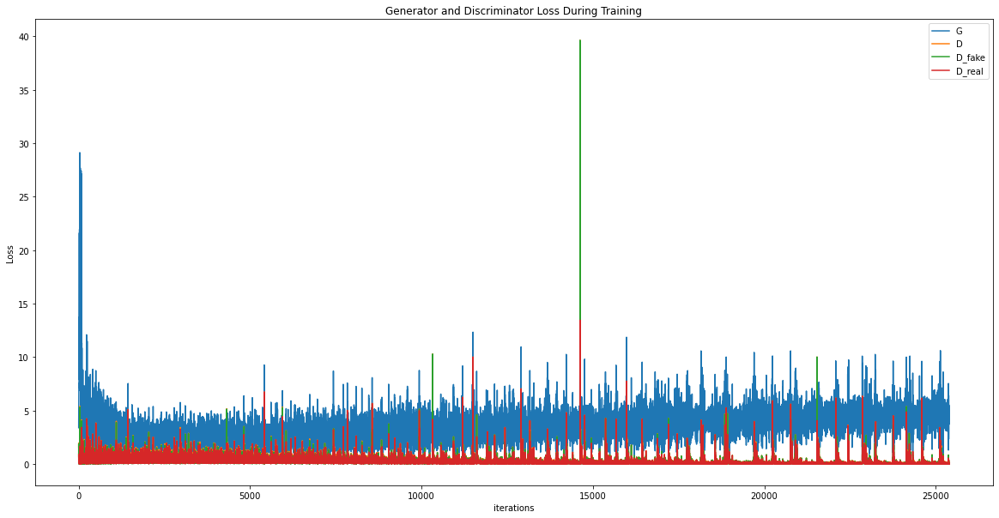

In [12]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.plot(D_fake_losses,label="D_fake")
plt.plot(D_real_losses,label="D_real")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.savefig(os.path.join(path,"generator_discriminator_losses.png"))

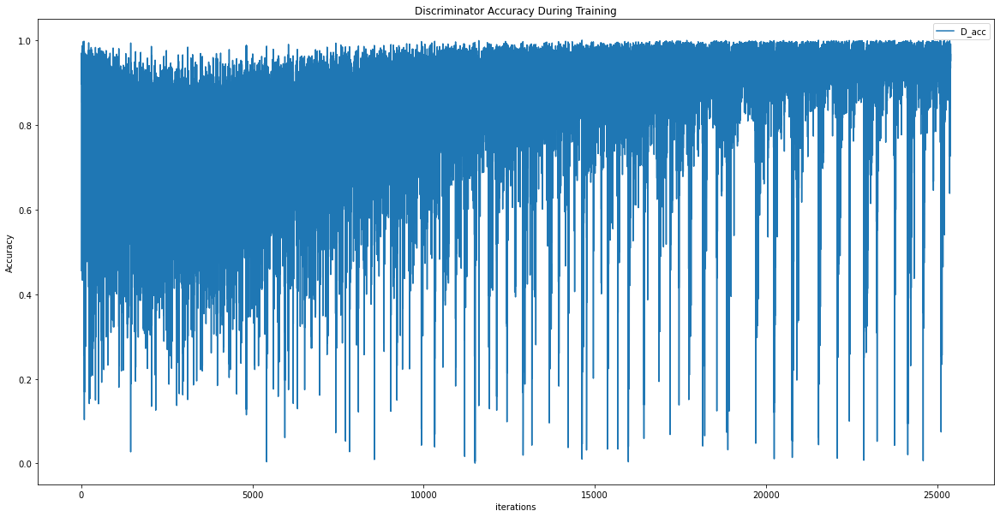

In [13]:
plt.figure(figsize=(20,10))
plt.title("Discriminator Accuracy During Training")
plt.plot(D_x_acc,label="D_acc")
plt.xlabel("iterations")
plt.ylabel("Accuracy")
plt.legend()
plt.savefig(os.path.join(path,"discriminator_accuracy.png"))

In [14]:
from scipy import stats


d_losses_mode = stats.mode(D_losses)
d_fake_losses_mode = stats.mode(D_fake_losses)
d_real_losses_mode = stats.mode(D_real_losses)
g_losses_mode = stats.mode(G_losses)

f = open(os.path.join(path,"overall_stats.txt"), "a")
f.write("Dataset: \t" + dataset_name +"\n")
f.write("Dataset size: \t" + str(dataset_size) +"\n")
f.write("D_losses mean: \t" + str(np.mean(D_losses)) +"\n")
f.write("D_losses mode: \t" + str(d_losses_mode.mode[0]) +"\n")
f.write("D_fake_losses mean: \t" + str(np.mean(D_fake_losses)) +"\n")
f.write("D_fake_losses mode: \t" + str(d_fake_losses_mode.mode[0]) +"\n")
f.write("D_real_losses mean: \t" + str(np.mean(D_real_losses)) +"\n")
f.write("D_real_losses mode: \t" + str(d_real_losses_mode.mode[0]) +"\n")
f.write("G_losses mean: \t" + str(np.mean(G_losses)) +"\n")
f.write("G_losses mode: \t" + str(g_losses_mode.mode[0]) +"\n")
f.write("Discriminator accuracy mean \t" + str(np.mean(D_x_acc)))

f.close()

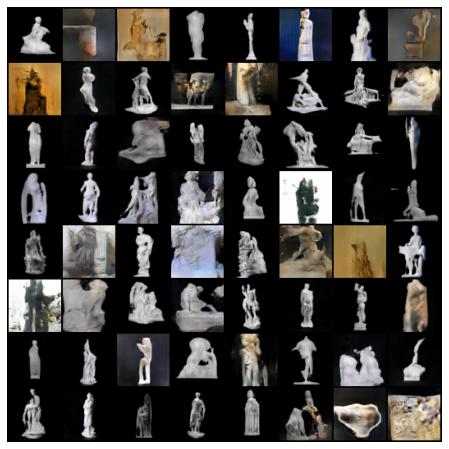

In [15]:
# Animation of generations over time

#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

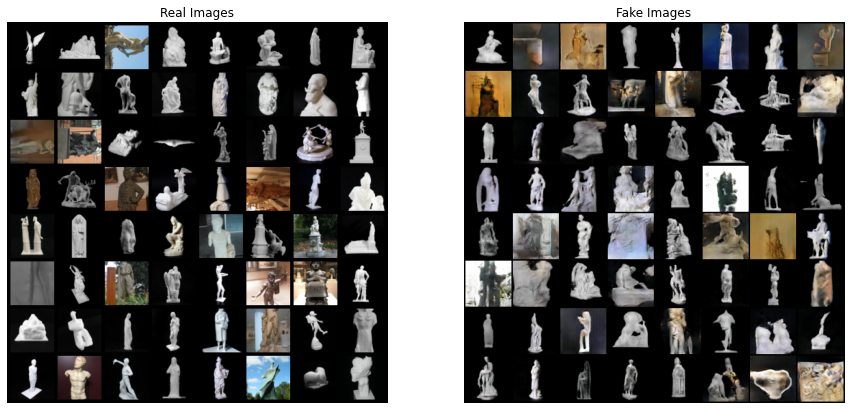

In [16]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.savefig(os.path.join(path,"real_vs_fake_images.png"))

In [17]:
from torchvision.utils import save_image

gen_img_dir = os.path.join(path, "generated_images")
if not os.path.exists(gen_img_dir):
    os.mkdir(gen_img_dir)
im_batch_size = 64
n_images=100
for i_batch in range(0, n_images, im_batch_size):
    gen_images = netG(fixed_noise)
    images = gen_images.to("cpu").clone().detach()
    images = images.numpy().transpose(0, 2, 3, 1)
    for i_image in range(gen_images.size(0)):
        save_image(gen_images[i_image, :, :, :], os.path.join(gen_img_dir, f'image_{i_batch+i_image:05d}.png'))

In [18]:
from zipfile import ZipFile
from os.path import basename


zip_file = home_dir + "outputs/" + results_dir + ".zip"
with ZipFile(zip_file, 'w') as zipObj:
   # Iterate over all the files in directory
   for folderName, subfolders, filenames in os.walk(path):
       for filename in filenames:
           #create complete filepath of file in directory
           filePath = os.path.join(folderName, filename)
           # Add file to zip
           zipObj.write(filePath, basename(filePath))